In [2]:
!pip install dataprep squarify lightgbm

In [1]:
import pandas as pd
import numpy as np
import re

# For data viz
from IPython.display import display
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.io as pio
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# For dataprep
from dataprep.eda import create_report, plot_missing
from dataprep import eda

# File system manangement
import os

# Stats indicator
from scipy.stats import chi2_contingency

plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['figure.dpi'] = 100

# pd.set_option('plotting.backend', 'plotly')
pd.set_option("display.min_rows", 10)
pd.set_option("display.max_columns", 50)
pd.set_option("max_colwidth", 100)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Add specific file
import sys
sys.path.append("./drive/MyDrive/P7_OC/")

In [2]:
import exploration as ex

# path = './drive/MyDrive/P7_OC/application_train.csv'

path = './application_train.csv'

https://www.kaggle.com/c/home-credit-default-risk/code?competitionId=9120&sortBy=voteCount

# EDA

## Overview of the dataset

+----+-------------+-------------+---------------+------------+----------------+
|    |      Taille |   Nb lignes |   Nb colonnes |   % de NaN |   Nb duplicats |
|----+-------------+-------------+---------------+------------+----------------|
|  0 | 3.75163e+07 |      307511 |           122 |       24.4 |              0 |
+----+-------------+-------------+---------------+------------+----------------+


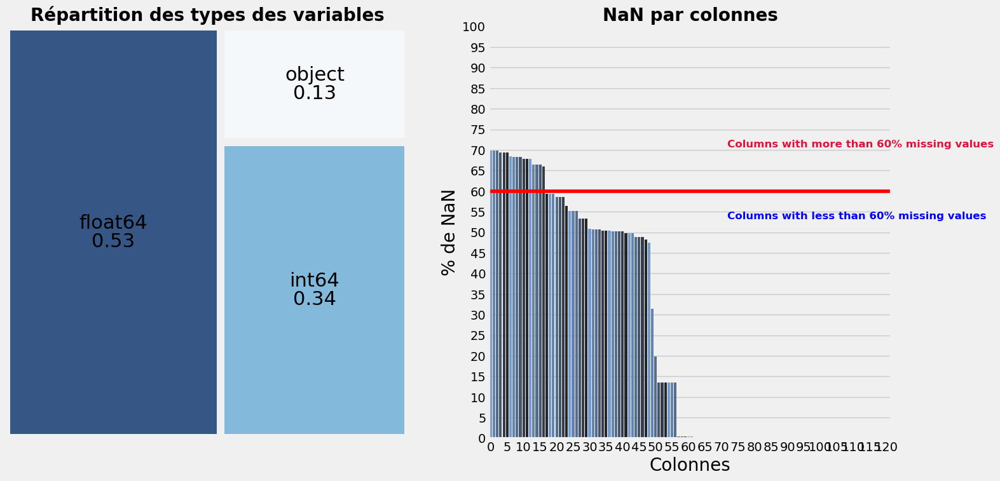

In [4]:
df = pd.read_csv(path)
ex.analyse_forme(df, all=True) # Vérifier xlabels + use plotly (treemap) ? 

In [ ]:
report = create_report(df)

In [ ]:
report.save(filename='full_report', to='./drive/MyDrive/P7_OC/')

  0%|          | 0/43 [00:00<?, ?it/s]


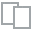
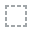
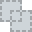
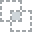
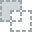
...
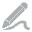
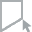
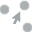
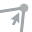
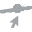

In [9]:
df.TARGET = pd.to_numeric(df.TARGET) # Target is an object

eda.plot(df, 'TARGET', display=['Stats', 'Bar Chart', 'Value Table'])

- TARGET indicating 0: the loan was repaid or 1: the loan was not repaid. <br>
This dataset has classification labels unbalanced.

## Numerical datas

In [ ]:
df.dtypes.value_counts()

float64    66
int64      40
object     16
bool        1
dtype: int64

### Correlations

As we saw, we have a lot of features to look to. <br> We want to only analyse the most relevant for predicting our target, to achieve this we compute the correlation of our variable.

We can interpret those correlations values with this table : <br>
- .00-.19 “very weak”
- .20-.39 “weak”
- .40-.59 “moderate”
- .60-.79 “strong”
- .80-1.0 “very strong”

In [ ]:
# Find correlations with the target and sort
correlations = pd.DataFrame(data=df.corr()['TARGET'])

type_ind_corr = []
for col in correlations.index:
  type_ind_corr.append(df[col].dtype)

correlations['type'] = type_ind_corr

In [ ]:
# Display correlations
correlations.TARGET = correlations.TARGET.abs()
print('Most important correlations:\n', correlations.sort_values(by='TARGET', ascending=False).iloc[1:11])
# print('\nMost Negative Correlations:\n', correlations.sort_values(by='TARGET').head(5))

Most important correlations:
                                TARGET     type
EXT_SOURCE_3                 0.178919  float64
EXT_SOURCE_2                 0.160472  float64
EXT_SOURCE_1                 0.155317  float64
DAYS_BIRTH                   0.078239    int64
DAYS_EMPLOYED                0.074958  float64
REGION_RATING_CLIENT_W_CITY  0.060893    int64
REGION_RATING_CLIENT         0.058899    int64
DAYS_LAST_PHONE_CHANGE       0.055218  float64
DAYS_ID_PUBLISH              0.051457    int64
REG_CITY_NOT_WORK_CITY       0.050994    int64


### EXT_SOURCE

According to the documentation, these features represent a "normalized score from external data source". I'm not sure what this exactly means, but it may be a cumulative sort of credit rating made using numerous sources of data.

                TARGET  EXT_SOURCE_1  EXT_SOURCE_2  EXT_SOURCE_3
TARGET        1.000000     -0.155317     -0.160472     -0.178919
EXT_SOURCE_1 -0.155317      1.000000      0.213982      0.186846
EXT_SOURCE_2 -0.160472      0.213982      1.000000      0.109167
EXT_SOURCE_3 -0.178919      0.186846      0.109167      1.000000


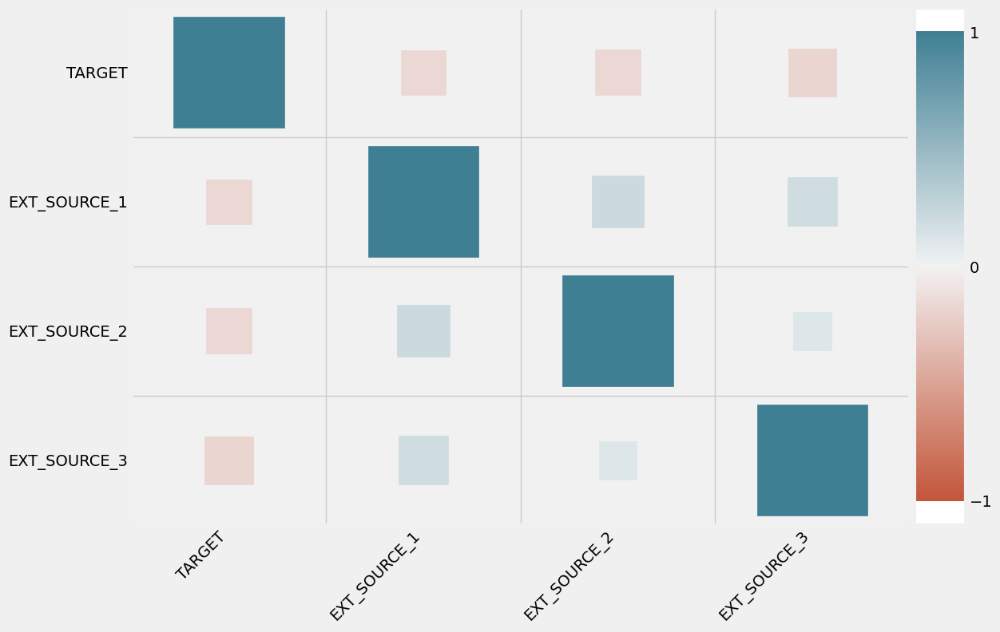

In [ ]:
correlations = df[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].corr()
print(correlations)
ex.corrplot(correlations, size_scale = 10000)

As the EXT_SOURCE_X increase, the customer is more likely to repay the loan.

### DAYS_EMPLOYED

In [ ]:
df['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

We create a new column indicating that those datas had anomalous values. We then replace them by nan values.

In [ ]:
# Create an anomalous flag column
df['DAYS_EMPLOYED_ANOM'] = df["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
df['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
df.DAYS_EMPLOYED = df.DAYS_EMPLOYED.abs()

print(f'{df["DAYS_EMPLOYED_ANOM"].sum()} anomalous values found.')

55374 anomalous values found.


In [ ]:
ex.mesure_forme_col(df.DAYS_EMPLOYED)

Nb de bins optimal estimé: 32


We are looking here for anomalies within our numericals datas.

### DAYS_BIRTH

In [ ]:
df.DAYS_BIRTH = df.DAYS_BIRTH.abs()
df.DAYS_BIRTH.describe()

count    307511.000000
mean      16036.995067
std        4363.988632
min        7489.000000
25%       12413.000000
50%       15750.000000
75%       19682.000000
max       25229.000000
Name: DAYS_BIRTH, dtype: float64

In [ ]:
ex.mesure_forme_col(df.DAYS_BIRTH / 365, title='Age of the client distribution')

In [ ]:
# Age information into a separate dataframe
age_data = df[['TARGET', 'DAYS_BIRTH']].copy(deep=True)
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))

# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()

# Graph the age bins and the average of the target as a bar plot
fig = px.bar(x=age_groups.index.astype(str), y=100 * age_groups['TARGET'], title='Failure to Repay by Age Group', labels={'x':'Age', 'y':'% of payment default'})

fig.show()

## Categorical datas

In [ ]:
# Number of unique classes in each object column
df.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

### Correlations

In the same idea as with numerical datas, I am looking for the variables that has the most impact in the target value. <br>
For that, I calculate the chi² between 'TARGET' and all the categorical variables. <br>
The higher chi², the more the impact in the repartition the variable have.

In [ ]:
# Display chi2 stats between all the categoricals feature and a specific one
col_target = 'TARGET'

results_chi2 = pd.DataFrame({'chi2':[], 'pvalue':[]})
for col_name in df.select_dtypes(include='object').columns:
  contingency_table = pd.crosstab(columns=df[col_target], index=df[col_name])
  chi2, pvalue, dof, expected = chi2_contingency(contingency_table)
  results_chi2.loc[col_name] = {'chi2':round(chi2,2), 'pvalue':round(pvalue,3)}

results_chi2.sort_values(by='chi2', ascending=False).head(5)

,chi2,pvalue
ORGANIZATION_TYPE,1609.24,0.0
OCCUPATION_TYPE,1402.85,0.0
NAME_INCOME_TYPE,1253.47,0.0
NAME_EDUCATION_TYPE,1019.21,0.0
CODE_GENDER,920.79,0.0


In [ ]:
# Display chi2 stats - the contigency table and the expected contigency table (if the 2 variables are independent)

col_name = 'NAME_CONTRACT_TYPE'

contingency_table = pd.crosstab(columns=df['TARGET'], index=df[col_name])
chi2, pvalue, dof, expected = chi2_contingency(contingency_table)
print(f'Chi2:{chi2:.2f}, pvalue:{pvalue:.2f}, dof:{dof}')

display(pd.crosstab(columns=df['TARGET'], index=df['NAME_CONTRACT_TYPE'], margins='all'))
expected_df = pd.DataFrame(expected)
expected_df.index = contingency_table.index
display(expected_df)

Chi2:293.15, pvalue:0.00, dof:1


TARGET,0,1,All
NAME_CONTRACT_TYPE,,,
Cash loans,255011,23221,278232
Revolving loans,27675,1604,29279
All,282686,24825,307511


,0,1
NAME_CONTRACT_TYPE,,
Cash loans,255770.659105,22461.340895
Revolving loans,26915.340895,2363.659105


### ORGANIZATION_TYPE


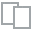
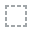
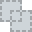
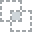
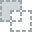
...
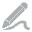
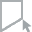
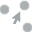
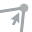
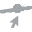

In [ ]:
eda.plot(df.ORGANIZATION_TYPE)

### OCCUPATION_TYPE


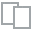
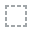
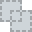
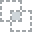
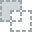
...
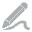
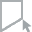
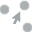
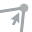
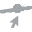

In [ ]:
eda.plot(df.OCCUPATION_TYPE)

### NAME_INCOME_TYPE


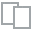
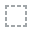
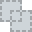
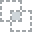
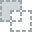
...
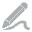
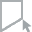
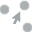
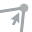
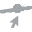

In [ ]:
eda.plot(df.NAME_INCOME_TYPE)

### NAME_EDUCATION_TYPE


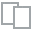
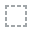
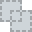
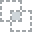
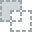
...
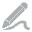
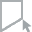
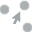
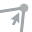
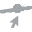

In [ ]:
eda.plot(df.NAME_EDUCATION_TYPE)

# Modélisation

## Preprocessing

In [3]:
# Preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split

# Models used
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

# Evaluating our models
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV


We label encode the object variables with two classes, the others will be one hot encoded. <br>

We do not face the main issue with label encoding when we have two values, because we will have a new boolean features. 
In this way, there is no introduction of order or some kind of more important labeling of a class 

In [4]:
def encoding(df):
    # Create a label encoder object
    le = LabelEncoder()
    le_count = 0

    # Iterate through the columns
    for col in df:
        if df[col].dtype == 'object':
          # If 2 or fewer unique categories
          if len(list(df[col].unique())) <= 2:
            # Train & transform the data
            le.fit(df[col])
            df[col] = le.transform(df[col])
            # Keep track of how many columns were label encoded
            le_count += 1

    print('%d columns were label encoded.' % le_count)

    # one-hot encoding of categorical variables
    tmp_shape = df.shape[1]
    df = pd.get_dummies(df)
    print(f'{df.shape[1] - tmp_shape} columns were one-hot encoded.')

    return df

def handle_outliers(df):
    ### DAYS_EMPLOYED_ANOM ###
    # Create an anomalous flag column
    df['DAYS_EMPLOYED_ANOM'] = df["DAYS_EMPLOYED"] == 365243
    # Replace the anomalous values with nan
    df['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
    df.DAYS_EMPLOYED = df.DAYS_EMPLOYED.abs()
    print(f'(DAYS_EMPLOYED) {df["DAYS_EMPLOYED_ANOM"].sum()} anomalous values found.')

    ### DAYS columns ###
    for col in df.columns[df.columns.str.contains('DAYS')]:
        df[col] = df[col].abs()

    ### Categorical XNA ###
    for col_name in df.select_dtypes(include='object').columns:
        if 'XNA' in (df[col_name].unique()):
            nb_xna = df[col_name].value_counts().loc['XNA']
            print(f'{nb_xna} XNAs found in {col_name}')
            df[col_name].replace('XNA', np.nan, inplace=True)

    return df  

def handle_nans(df):
    print(f'{df.isna().sum().sum()} nans found.')
    imputer = SimpleImputer(strategy='median')

    col_num = df.select_dtypes(include=np.number).columns
    imputer.fit(df[col_num])
    df[col_num] = imputer.transform(df[col_num])

    return df

def scaling(train, test, s=MinMaxScaler, **params_scaler):
    print(f'Scaling with {s} \nParams: {params_scaler}')
    scaler = s(**params_scaler)

    col_num = train.select_dtypes(include=np.number).columns
    scaler.fit(train[col_num])

    train[col_num] = scaler.transform(train[col_num])
    test[col_num] = scaler.transform(test[col_num])

    return train, test

In [5]:
def preprocessing(data, s=MinMaxScaler, **params_scaler):
    df = data.copy(deep=True)

    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x)) # Delete special JSON characters from column names
    
    print("Handling Outliers".center(50, '-'))
    df = handle_outliers(df)
    print()

    print("Encoding".center(50, '-'))
    df = encoding(df) # TARGET will not be treated as categorical variable here
    print()  

    print('Splitting in train/test set'.center(50, '-'))
    train, test = train_test_split(df, test_size=0.2, random_state=42, stratify=df['TARGET'])
    X_train = train.drop('TARGET', axis=1);   y_train = train.TARGET
    X_test = test.drop('TARGET', axis=1);  y_test = test.TARGET
    print('train:', X_train.shape);  print('test:', X_test.shape)
    print()

    print("Handling NaNs".center(50, '-'))
    print('train:', end=' '); X_train = handle_nans(X_train)
    print('test: ', end=' '); X_test = handle_nans(X_test)
    print()

    print("Scaling".center(50, '-'))
    X_train, X_test = scaling(X_train, X_test, s, **params_scaler)
    print()

    return X_train, y_train, X_test, y_test

In [6]:
df = pd.read_csv(path)

## Metrics

**Accuracy**: What % of customers that did not succeed to repay the loan was predicted ? <br>
**AUROC**: Area Under the Receiver Operating Characteristic <br>
**Precision**: What % of predictions of customers that did not repay are correct ? <br>
**Recall**: What % of customers that did not repay are correctly classified ? <br>
**F1-score**: Harmonic-mean of Precision & Recall <br>

In [7]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [8]:
def classif_score(y_true, X_test, model, name_model, display_cm = True):
    
    y_pred = model.predict(X_test).astype('int')
    
    if display_cm:
        cm = confusion_matrix(y_true, y_pred)
        make_confusion_matrix(cm, sum_stats=False, cbar=False, figsize=(4,4), title='Confusion Matrix')

    data = {'Accuracy': round(accuracy_score(y_true, y_pred), 3),
          'AUROC': round(roc_auc_score(y_true, model.predict_proba(X_test)[:,1]), 3),
          'Precision': round(precision_score(y_true, y_pred), 3),
          'Recall': round(recall_score(y_true, y_pred), 3),
          'F1-Score': round(f1_score(y_true, y_pred), 3),          
        }
    return pd.DataFrame(data, index=[name_model])

In [9]:
def train_model(X_train, y_train, model, grid, scoring='roc_auc'):
    model_cv = GridSearchCV(model, grid, cv=5, scoring=scoring, verbose=2, error_score='raise', n_jobs=-1)

    # Train on the training data
    model_cv.fit(X_train, y_train)
    
    return model_cv

## Sampling

To accelerate the fitting process, we sample our train set.

In [10]:
def sample_data(X_train, y_train, nb_samples=30000):

    stacked = pd.concat([X_train, y_train], axis=1)
    arr_sampled, _ = train_test_split(stacked, train_size=nb_samples, stratify=stacked['TARGET'])
    
    arr_sampled_df = pd.DataFrame(arr_sampled, columns=stacked.columns)
    X_train_s = arr_sampled_df.drop('TARGET', axis=1) # Delete Target columns
    y_train_s = arr_sampled_df.TARGET

    # Checking stratification
    print(X_train_s.shape)
    print(y_train_s.shape)
    print(y_train_s.value_counts()/len(y_train_s))

    return X_train_s, y_train_s

## Without handling imbalanced target

### Dummy classifier

In [32]:
X_train, y_train, X_test, y_test = preprocessing(df)
X_train_s, y_train_s = sample_data(X_train, y_train, nb_samples=30000)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 241)


,Accuracy,AUROC,Precision,Recall,F1-Score
DummyClassifier,0.85,0.5,0.08,0.08,0.08


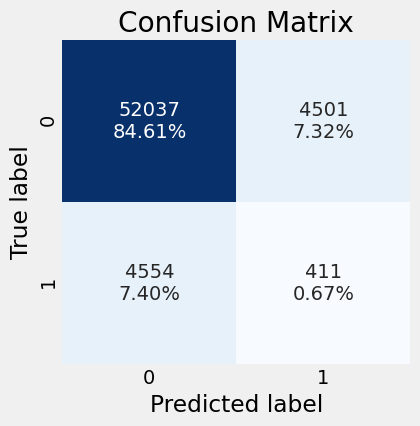

In [20]:
dummy = DummyClassifier(strategy='stratified', random_state=42)
dummy.fit(X_train_s, y_train_s)

classif_score(y_test, X_test, dummy, 'DummyClassifier')

### Logistic-regression

In [21]:
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

In [22]:
grid= {'C':np.logspace(-3,3,5), # Inverse of regularization strength:  smaller values specify stronger regularization.
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

log_reg_cv = train_model(X_train_s, y_train_s, LogisticRegression(random_state=42, max_iter=100), grid=grid)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   26.7s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:  3.8min finished


Tuned hyperparameters :(best parameters)  {'C': 1.0, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


,Accuracy,AUROC,Precision,Recall,F1-Score
Log-Reg,0.92,0.74,0.49,0.01,0.02


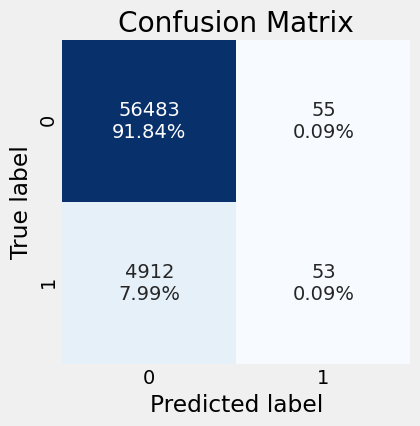

In [23]:
print("Tuned hyperparameters :(best parameters) ",log_reg_cv.best_params_)
classif_score(y_test, X_test, log_reg_cv.best_estimator_, 'Log-Reg')

### Decision Tree

In [34]:
grid = {
        'max_depth': np.linspace(10,50,6), 
        'min_samples_split': np.linspace(50,1000,10).astype('int'),
}

d_tree_cv = train_model(X_train_s, y_train_s, DecisionTreeClassifier(random_state=42), grid=grid)

Fitting 5 folds for each of 60 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   25.8s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed:  7.0min finished


Tuned hyperparameters :(best parameters)  {'max_depth': 10.0, 'min_samples_split': 1000}


,Accuracy,AUROC,Precision,Recall,F1-Score
Decision Tree,0.92,0.69,0.06,0.0,0.0


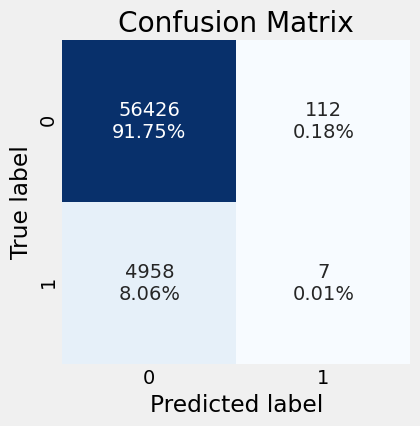

In [35]:
print("Tuned hyperparameters :(best parameters) ",d_tree_cv.best_params_)
classif_score(y_test, X_test, d_tree_cv.best_estimator_, 'Decision Tree')

### Random Forest

In [36]:
grid = {
    'max_depth': np.linspace(5,15,5).astype('int'), #Top 1 
    'min_samples_split': np.linspace(50,1000,10).astype('int'),
}

rf_cv = train_model(X_train_s, y_train_s, RandomForestClassifier(random_state=42, n_estimators=200), grid=grid)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   39.0s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed:  9.1min finished


Best parameters {'max_depth': 12, 'min_samples_split': 577}
Best score 0.7246174677328403


C:\Users\sebas\anaconda3\envs\dl-venv\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,Accuracy,AUROC,Precision,Recall,F1-Score
Random-Forest,0.92,0.73,0.0,0.0,0.0


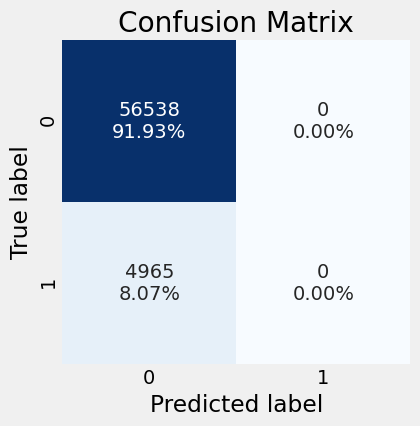

In [41]:
print("Best parameters",rf_cv.best_params_)
print('Best score', rf_cv.best_score_)
classif_score(y_test, X_test, rf_cv.best_estimator_, 'Random-Forest')

### LGBM

In [38]:
import lightgbm as lgb

In [39]:
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # Apprenant faible car boosting --> max_depth de 1 à 5
      'reg_alpha': np.linspace(0,1,4),
      'reg_lambda': np.linspace(0,1,4)
} 

gbm_cv = train_model(X_train_s, y_train_s, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200), grid=grid)

Fitting 5 folds for each of 192 candidates, totalling 960 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   26.8s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:  7.6min
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed: 14.2min
[Parallel(n_jobs=-1)]: Done 960 out of 960 | elapsed: 22.1min finished


Best parameters {'max_depth': 1, 'num_leaves': 25, 'reg_alpha': 0.0, 'reg_lambda': 0.3333333333333333}
Best score 0.7429639314078476


,Accuracy,AUROC,Precision,Recall,F1-Score
gbm,0.92,0.75,0.55,0.01,0.02


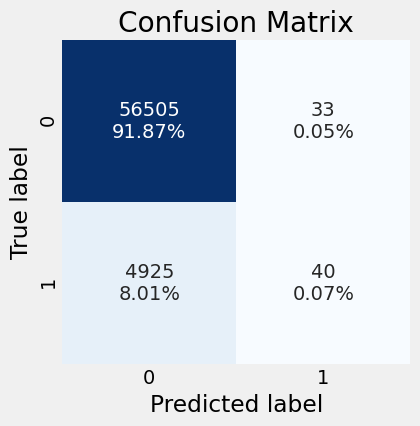

In [40]:
print("Best parameters",gbm_cv.best_params_)
print('Best score', gbm_cv.best_score_)
classif_score(y_test, X_test,gbm_cv.best_estimator_,'gbm')

### Final results

In [47]:
pd.concat(
    [classif_score(y_test, X_test, dummy, 'DummyClassifier', False),
    classif_score(y_test, X_test, d_tree_cv.best_estimator_, 'Decision Tree', False),
    classif_score(y_test, X_test, log_reg_cv.best_estimator_, 'Log-Reg', False),
    classif_score(y_test, X_test, rf_cv.best_estimator_, 'Random-Forest', False),
    classif_score(y_test, X_test,gbm_cv.best_estimator_, 'LightGBM', False) 
    ])

C:\Users\sebas\anaconda3\envs\dl-venv\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,Accuracy,AUROC,Precision,Recall,F1-Score
DummyClassifier,0.85,0.50,0.08,0.08,0.08
Decision Tree,0.92,0.69,0.06,0.00,0.00
Log-Reg,0.92,0.74,0.49,0.01,0.02
Random-Forest,0.92,0.73,0.00,0.00,0.00
LightGBM,0.92,0.75,0.55,0.01,0.02


## Handling imbalanced target

### Logistic-regression

In [21]:
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

In [49]:
grid= {'C':[0.01, 0.1, 1, 5, 10, 50],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

log_reg_cv = train_model(X_train_s, y_train_s, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   29.7s
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  4.8min finished


Tuned hyperparameters :(best parameters)  {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


,Accuracy,AUROC,Precision,Recall,F1-Score
Log-Reg,0.69,0.74,0.16,0.66,0.26


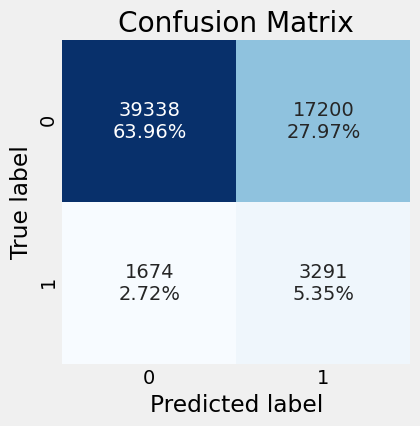

In [50]:
print("Tuned hyperparameters :(best parameters) ",log_reg_cv.best_params_)
classif_score(y_test, X_test, log_reg_cv.best_estimator_, 'Log-Reg')

### Decision Tree

In [52]:
grid = {
        'max_depth': np.linspace(5,50,6), 
        'min_samples_split': np.linspace(100,10000,10).astype('int'),
}

d_tree_cv = train_model(X_train_s, y_train_s, DecisionTreeClassifier(random_state=42, class_weight='balanced'), grid=grid)

Fitting 5 folds for each of 60 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   23.5s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed:  6.7min finished


Tuned hyperparameters :(best parameters)  {'max_depth': 14.0, 'min_samples_split': 2300}


,Accuracy,AUROC,Precision,Recall,F1-Score
Decision Tree,0.59,0.7,0.13,0.71,0.22


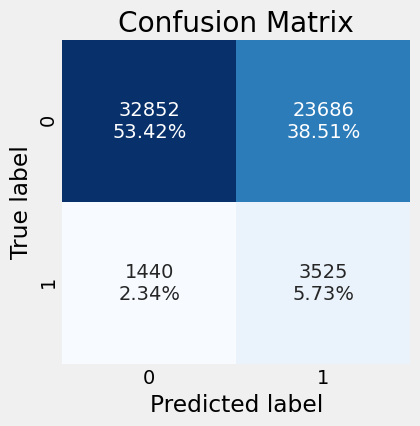

In [53]:
print("Tuned hyperparameters :(best parameters) ",d_tree_cv.best_params_)
classif_score(y_test, X_test, d_tree_cv.best_estimator_, 'Decision Tree')

### Random Forest

In [56]:
grid = {
    'max_depth': np.linspace(5,15,5).astype('int'), #Top 1 
    'min_samples_split': np.linspace(50,1000,10).astype('int'),
    'class_weight':['balanced', 'balanced_subsample']
}

rf_cv = train_model(X_train_s, y_train_s, RandomForestClassifier(random_state=42, n_estimators=200), grid=grid)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   40.4s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed: 12.0min
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed: 17.9min finished


Best parameters {'class_weight': 'balanced_subsample', 'max_depth': 15, 'min_samples_split': 472}
Best score 0.7245782523070945


,Accuracy,AUROC,Precision,Recall,F1-Score
Random-Forest,0.79,0.73,0.19,0.5,0.28


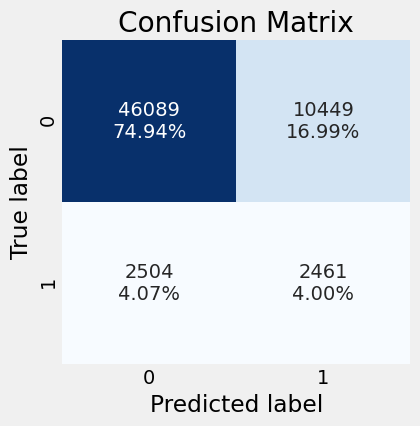

In [57]:
print("Best parameters",rf_cv.best_params_)
print('Best score', rf_cv.best_score_)
classif_score(y_test, X_test, rf_cv.best_estimator_, 'Random-Forest')

### LGBM

In [58]:
import lightgbm as lgb

In [59]:
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': np.linspace(0,1,4),
      'reg_lambda': np.linspace(0,1,4)
} 

gbm_cv = train_model(X_train_s, y_train_s, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)

Fitting 5 folds for each of 192 candidates, totalling 960 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   25.0s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:  7.6min
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed: 13.9min
[Parallel(n_jobs=-1)]: Done 960 out of 960 | elapsed: 21.6min finished


Best parameters {'max_depth': 1, 'num_leaves': 25, 'reg_alpha': 0.6666666666666666, 'reg_lambda': 1.0}
Best score 0.7392844038724234


,Accuracy,AUROC,Precision,Recall,F1-Score
gbm,0.69,0.75,0.16,0.67,0.26


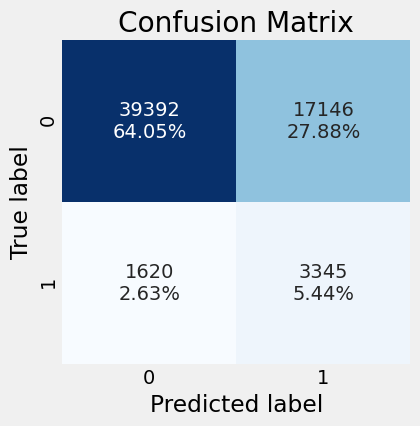

In [60]:
print("Best parameters",gbm_cv.best_params_)
print('Best score', gbm_cv.best_score_)
classif_score(y_test, X_test,gbm_cv.best_estimator_,'gbm')

### Final results

In [61]:
pd.concat(
    [classif_score(y_test, X_test, dummy, 'DummyClassifier', False),
    classif_score(y_test, X_test, d_tree_cv.best_estimator_, 'Decision Tree', False),
    classif_score(y_test, X_test, log_reg_cv.best_estimator_, 'Log-Reg', False),
    classif_score(y_test, X_test, rf_cv.best_estimator_, 'Random-Forest', False),
    classif_score(y_test, X_test,gbm_cv.best_estimator_, 'LightGBM', False) 
    ])

,Accuracy,AUROC,Precision,Recall,F1-Score
DummyClassifier,0.85,0.50,0.08,0.08,0.08
Decision Tree,0.59,0.70,0.13,0.71,0.22
Log-Reg,0.69,0.74,0.16,0.66,0.26
Random-Forest,0.79,0.73,0.19,0.50,0.28
LightGBM,0.69,0.75,0.16,0.67,0.26


# Features Engineering

For the following training, we'll focus on the two models that gave us the best AUROC score: Logistic Regression and LightGBM

In [11]:
from sklearn.preprocessing import MinMaxScaler 
from sklearn.neighbors import KDTree
from sklearn.feature_selection import VarianceThreshold

In [12]:
df_2 = df.copy(deep=True)

## Creation of new features

Here, we create some new features in order to improve the performance of the model:
 - Age is a pretty explicit feature
 - credit_annuity_ratio is the ratio a loan is compared to the whole credit (between 0 and 1)
 - credit_goods_ratio is the ratio of the credit compared to the price the customer will buy with
 - credit_income_ratio is the ratio of the credit compared to the total income of the client
 - annuity_income_ratio is the ratio of the annuity compared to the income of the client
 - days_employed_life is the % of time spent working in the whole life of the client
 - target_50_nn is the mean of the target of the 50 others customers "similar" (Nearest neighbors using EXT_SOURCEs and credit_annuity_ratio)

In [13]:
def adding_features(df, target):
    age = df.DAYS_BIRTH/365
    
    # AMT_CREDIT: Credit amount of the loan ; AMT_ANNUITY: Loan annuity
    credit_annuity_ratio = df.AMT_CREDIT /  df.AMT_ANNUITY
    credit_goods_price_ratio =  df.AMT_CREDIT / df.AMT_GOODS_PRICE
    credit_income_ratio =  df.AMT_CREDIT / df.AMT_INCOME_TOTAL
    annuity_income_ratio = df.AMT_ANNUITY / df.AMT_INCOME_TOTAL
    days_employed_life = df_2.DAYS_EMPLOYED / df_2.DAYS_BIRTH
    
    
    tmp = df[['EXT_SOURCE_3', 'EXT_SOURCE_2', 'EXT_SOURCE_1']]
    tmp = pd.concat([tmp, credit_annuity_ratio.rename('CREDIT_ANNUITY_RATIO')], axis=1) 
    
    # Computing Nearest Neigbors
    scaler = MinMaxScaler()
    scaled = scaler.fit_transform(tmp)
    
    kdt = KDTree(scaled)
    
    mean_target_50_nn = []

    for index, row in enumerate(scaled):
        indices = kdt.query(row.reshape(1,-1), 50, return_distance = False) # Compute the 50 nearest neighbors of a given line
        if target.iloc[indices[0]].mean() >= 0.5: # Determine the mean of the target of the 500nearest neighbors
            mean_target_50_nn.append(1)
        else: 
            mean_target_50_nn.append(0)
            
    # Adding new features to the dataframe
    df['AGE'] = age
    df['CREDIT_ANNUITY_RATIO'] = credit_annuity_ratio
    df['CREDIT_GOODS_PRICE_RATIO'] = credit_goods_price_ratio
    df['CREDIT_INCOME_RATIO'] = credit_income_ratio
    df['ANNUITY_INCOME_RATIO'] = annuity_income_ratio
    df['DAYS_EMPLOYED_LIFE'] = days_employed_life
    
    df['TARGET_50_NN'] = mean_target_50_nn
    
    print('Features added.')
    
    return df

## Deleting correlated features

In [14]:
def delete_correl_features(df, to_drop):
    return df.drop(to_drop, axis=1)

----

<AxesSubplot:>

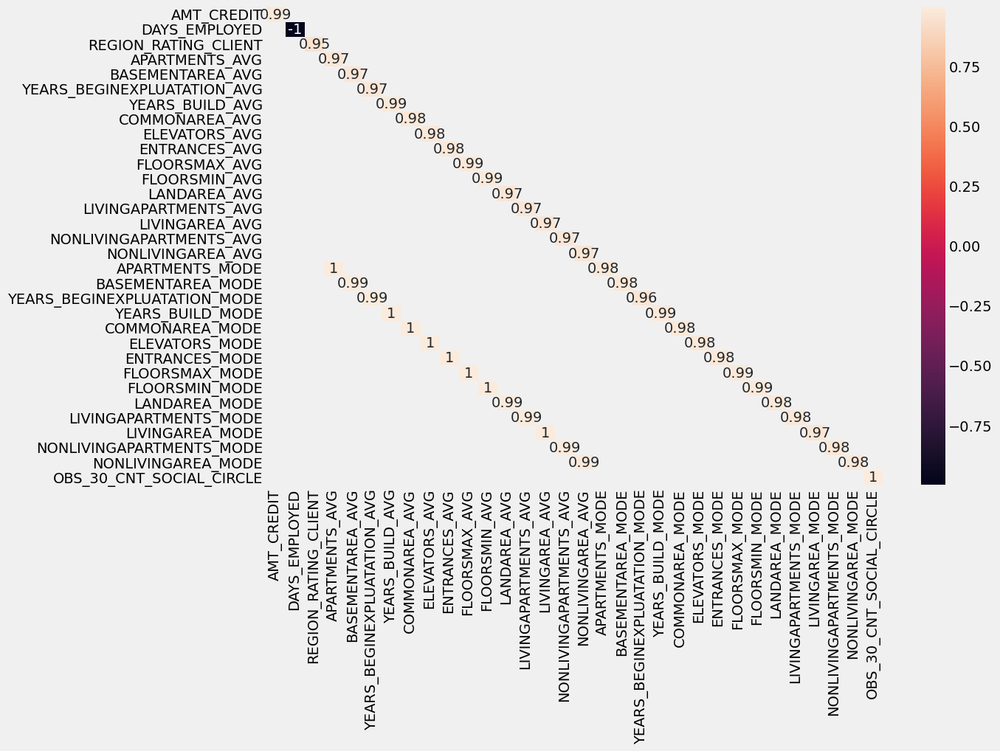

In [240]:
corr = df_2.corr()
# Fill diagonal and upper half with NaNs
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
corr[mask] = np.nan
corr[corr.abs() < 0.95] = np.nan

corr = corr.dropna(how='all').dropna(how='all', axis=1)
sns.heatmap(corr, annot=True, xticklabels=corr.columns.values, yticklabels=corr.columns.values)# (corr

In [244]:
high_corr = pd.DataFrame(columns={'col1', 'col2', 'value'})

for col in corr.columns:
    for index in corr.index:
        if not (np.isnan(corr.loc[index][col])):
            high_corr = high_corr.append(pd.DataFrame({'col1':[index], 'col2':[col], 'value':[corr.loc[index][col]]}), ignore_index=True)
            
high_corr.sort_values(by='col2')

,col2,col1,value
0,AMT_CREDIT,AMT_GOODS_PRICE,0.986968
4,APARTMENTS_AVG,APARTMENTS_MEDI,0.995081
3,APARTMENTS_AVG,APARTMENTS_MODE,0.973259
31,APARTMENTS_MODE,APARTMENTS_MEDI,0.977193
5,BASEMENTAREA_AVG,BASEMENTAREA_MODE,0.973496
6,BASEMENTAREA_AVG,BASEMENTAREA_MEDI,0.994317
32,BASEMENTAREA_MODE,BASEMENTAREA_MEDI,0.977938
11,COMMONAREA_AVG,COMMONAREA_MODE,0.977147
12,COMMONAREA_AVG,COMMONAREA_MEDI,0.995978
35,COMMONAREA_MODE,COMMONAREA_MEDI,0.979887


In [258]:
to_keep = ['YEAR_BUILD_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'REGION_RATING_CLIENT', 'NONLIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'LIVING_AREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LANDAREA_MEDI', 'FLOORSMIN_MEDI',
          'FLOORSMIN_MEDI', 'FLOORSMAX_MEDI', 'ENTRANCES_MEDI', 'COMMONAREA_MEDI', 'BASEMENTAREA_MEDI', 'APARTMENTS_MEDI']

to_drop = ['YEARS_BUILD_AVG', 'YEARS_BUILD_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BEGINEXPLUATATION_AVG', 'REGION_RATING_CLIENT_W_CITY', 'OBS_60_CNT_SOCIAL_CIRCLE',
          'NONLIVINGAREA_AVG', 'NONLIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'LIVINGAREA_MODE',
           'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MODE', 'LANDAREA_AVG', 'LANDAREA_MODE', 'FLOORSMIN_MODE', 'FLOORSMIN_AVG', 'FLOORSMAX_MODE', 'FLOORSMAX_AVG', 
           'ENTRANCES_AVG', 'ENTRANCES_MODE', 'ELEVATORS_AVG', 'ELEVATORS_MODE', 'COMMONAREA_AVG', 'COMMONAREA_MODE', 'BASEMENTAREA_MODE', 'BASEMENTAREA_AVG', 'APARTMENTS_AVG', 'APARTMENTS_MODE', 'FLAG_EMP_PHONE'
          ]

## Variance Threshold

In [15]:
def delete_low_var(X_train, X_test, var_th=0.001):  
    selector = VarianceThreshold(threshold=var_th)
    selector.fit(X_train)
    col_to_drop = X_train.columns[~selector.get_support()] # Easier to debug
    print(f'With var_th={var_th}: {len(col_to_drop)} columns dropped.')
    X_train = X_train.drop(col_to_drop, axis=1)
    X_test = X_test.drop(col_to_drop, axis=1)
    
    return X_train, X_test

---

In [19]:
(X_train_2.var() < 0.01).sum()

114

## Select from model

In [16]:
from sklearn.feature_selection import SelectFromModel

def delete_from_model(X_train, y_train, X_test, threshold_from_model='mean'):
    selector = SelectFromModel(DecisionTreeClassifier(random_state=42), threshold=threshold_from_model)
    selector.fit(X_train, y_train)
    
    col_to_drop = X_train.columns[~selector.get_support()] # Easier to debug
    print(f'With threshold={threshold_from_model}: {len(col_to_drop)} columns dropped.')
    X_train = X_train.drop(col_to_drop, axis=1)
    X_test = X_test.drop(col_to_drop, axis=1)
    
    return X_train, X_test

## Results

Here we are going to measure the impact of feature engineering on our results

In [41]:
def preprocessing_fe(data, delete_correl = False, adding_f = False, low_var = False, var_th = 0.01, from_model=False, s=MinMaxScaler, **params_scaler):
    df = data.copy(deep=True)
    
    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x)) # Delete special JSON characters from column names
    if delete_correl:
        df = delete_correl_features(df, to_drop = ['YEARS_BUILD_AVG', 'YEARS_BUILD_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BEGINEXPLUATATION_AVG', 'REGION_RATING_CLIENT_W_CITY', 'OBS_60_CNT_SOCIAL_CIRCLE',
              'NONLIVINGAREA_AVG', 'NONLIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'LIVINGAREA_MODE',
               'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MODE', 'LANDAREA_AVG', 'LANDAREA_MODE', 'FLOORSMIN_MODE', 'FLOORSMIN_AVG', 'FLOORSMAX_MODE', 'FLOORSMAX_AVG', 
               'ENTRANCES_AVG', 'ENTRANCES_MODE', 'ELEVATORS_AVG', 'ELEVATORS_MODE', 'COMMONAREA_AVG', 'COMMONAREA_MODE', 'BASEMENTAREA_MODE', 'BASEMENTAREA_AVG', 'APARTMENTS_AVG', 'APARTMENTS_MODE', 'FLAG_EMP_PHONE'
              ])

    print("Handling Outliers".center(50, '-'))
    df = handle_outliers(df)
    print()

    print("Encoding".center(50, '-'))
    df = encoding(df) # TARGET will not be treated as categorical variable here
    print()  

    print('Splitting in train/test set'.center(50, '-'))
    train, test = train_test_split(df, test_size=0.2, random_state=42, stratify=df['TARGET'])
    X_train = train.drop('TARGET', axis=1);   y_train = train.TARGET
    X_test = test.drop('TARGET', axis=1);  y_test = test.TARGET
    print('train:', X_train.shape);  print('test:', X_test.shape)
    print()
    
    print("Handling NaNs".center(50, '-'))
    print('train:', end=' '); X_train = handle_nans(X_train)
    print('test: ', end=' '); X_test = handle_nans(X_test)
    print()
    
    if adding_f:
        print("Adding Features".center(50, '-'))
        print('train:', end=' '); X_train = adding_features(X_train, y_train)
        print('test: ', end=' '); X_test = adding_features(X_test, y_test)
        print()
        
    if low_var:
        print("Deleting low variance features".center(50, '-'))
        X_train, X_test = delete_low_var(X_train, X_test, var_th)
        print()
        
        
    if from_model:
        print("Deleting with model features importance".center(50, '-'))
        X_train, X_test = delete_from_model(X_train, y_train, X_test, threshold_from_model='mean')
        print()

    print("Scaling".center(50, '-'))
    X_train, X_test = scaling(X_train, X_test, s, **params_scaler)
    print()

    return X_train, y_train, X_test, y_test

### Adding features

#### Logistic Regression

In [18]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=False, delete_low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_no_fe = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Without FE', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 241)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Wall time: 2min 1s


In [19]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, delete_low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_add_fe = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Features added', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 248)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Wall time: 3min 13s


In [20]:
pd.concat([log_reg_no_fe, log_reg_add_fe])

,Accuracy,AUROC,Precision,Recall,F1-Score
Without FE,0.693,0.741,0.16,0.660,0.257
Features added,0.693,0.742,0.16,0.659,0.257


---

**Amélioration du ROC AUC de 0.001**

#### LBGM

In [24]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=False, delete_low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_no_fe = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Without FE', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 241)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 1min 16s


In [25]:
%%time
X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, delete_low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_add_fe = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Feature added', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 248)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 2min 19s


In [26]:
pd.concat([gbm_cv_no_fe, gbm_cv_add_fe])

,Accuracy,AUROC,Precision,Recall,F1-Score
Without FE,0.707,0.746,0.166,0.655,0.265
Feature added,0.735,0.747,0.174,0.607,0.270


---

**Amélioration du ROC AUC de 0.001**

### Feature Selection

Here we are going to evaluate differents ways of performing feature selection in order to optimize our score.

#### Logistic Regression

In [34]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_no_fs = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Without FSelection', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 248)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Wall time: 3min 17s


In [35]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=True, adding_f=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_delete_correl = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Deleted Correl', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 210)
test: (61503, 210)

------------------Handling NaNs-------------------
train: 2727123 nans found.
test:  683164 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 217)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Wall time: 2min 52s


In [42]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, low_var=True, var_th=0.01)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_delete_low_var = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Deleted Low Var', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

----------Deleting low variance features----------
With var_th=0.01: 126 columns dropped.
---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 122)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\Users\sebas\anaconda3\envs\dl-venv\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Wall time: 2min 22s


In [44]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=True, adding_f=True, low_var=True, var_th=0.01)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_delete_correl_and_low_var = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Deleted Low Var + correl', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 210)
test: (61503, 210)

------------------Handling NaNs-------------------
train: 2727123 nans found.
test:  683164 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

----------Deleting low variance features----------
With var_th=0.01: 101 columns dropped.
---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 116)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits


C:\Users\sebas\anaconda3\envs\dl-venv\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Wall time: 2min 17s


In [45]:
%%time
grid= {'C':[0.01, 0.1, 1, 5],
       'penalty':['elasticnet'],
       'l1_ratio': np.linspace(0,1,5),
       'solver': ['saga']
       }

X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, from_model=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

log_reg_cv = train_model(X_train_s2, y_train_s2, LogisticRegression(random_state=42, max_iter=100, class_weight='balanced'), grid=grid)
log_reg_delete_with_model = classif_score(y_test_2, X_test_2, log_reg_cv.best_estimator_, 'Deleted with model', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

-----Deleting with model features importance------
With threshold=mean: 205 columns dropped.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 43)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Wall time: 2min 10s


In [46]:
pd.concat([log_reg_no_fs, log_reg_delete_correl, log_reg_delete_low_var, log_reg_delete_correl_and_low_var, log_reg_delete_with_model])

,Accuracy,AUROC,Precision,Recall,F1-Score
Without FSelection,0.689,0.742,0.159,0.666,0.257
Deleted Correl,0.687,0.743,0.158,0.667,0.256
Deleted Low Var,0.690,0.743,0.159,0.661,0.256
Deleted Low Var + correl,0.693,0.742,0.160,0.660,0.258
Deleted with model,0.683,0.734,0.155,0.655,0.250


---

**Amélioration max de 0.0**

#### LBGM

In [47]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_no_fs = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Without FSelection', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 248)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 2min 11s


In [48]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=True, adding_f=True, low_var=False)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_delete_correl = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Deleted Correl', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 210)
test: (61503, 210)

------------------Handling NaNs-------------------
train: 2727123 nans found.
test:  683164 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 217)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 2min 5s


In [49]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, low_var=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_low_var = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Deleted low variance', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

----------Deleting low variance features----------
With var_th=0.01: 126 columns dropped.
---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 122)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 1min 48s


In [50]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=True, adding_f=True, low_var=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_delete_correl_and_low_var = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Deleted correl + low variance', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 210)
test: (61503, 210)

------------------Handling NaNs-------------------
train: 2727123 nans found.
test:  683164 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

----------Deleting low variance features----------
With var_th=0.01: 101 columns dropped.
---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 116)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 1min 42s


In [51]:
%%time
grid = {
      'num_leaves':np.linspace(25, 100, 4).astype('int'),
      'max_depth': np.linspace(1,5,3).astype('int'), # weak learner
      'reg_alpha': [0.66], #np.linspace(0,1,4),
      'reg_lambda': [1], # np.linspace(0,1,4)
} 


X_train_2, y_train_2, X_test_2, y_test_2 = preprocessing_fe(df_2, delete_correl=False, adding_f=True, low_var=False, from_model=True)
X_train_s2, y_train_s2 = sample_data(X_train_2, y_train_2, nb_samples=30000)

gbm_cv = train_model(X_train_s2.values, y_train_s2.values, lgb.LGBMClassifier(random_state=42, learning_rate=0.2, n_estimators=200, class_weight='balanced'), grid=grid)
gbm_cv_delete_with_model = classif_score(y_test_2, X_test_2, gbm_cv.best_estimator_, 'Deleted with model', display_cm=False)

----------------Handling Outliers-----------------
(DAYS_EMPLOYED) 55374 anomalous values found.
4 XNAs found in CODE_GENDER
55374 XNAs found in ORGANIZATION_TYPE

---------------------Encoding---------------------
3 columns were label encoded.
119 columns were one-hot encoded.

-----------Splitting in train/test set------------
train: (246008, 241)
test: (61503, 241)

------------------Handling NaNs-------------------
train: 6751520 nans found.
test:  1691948 nans found.

-----------------Adding Features------------------
train: Features added.
test:  Features added.

-----Deleting with model features importance------
With threshold=mean: 205 columns dropped.

---------------------Scaling----------------------
Scaling with <class 'sklearn.preprocessing._data.MinMaxScaler'> 
Params: {}

(30000, 43)
(30000,)
0    0.919267
1    0.080733
Name: TARGET, dtype: float64
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Wall time: 2min 2s


In [52]:
pd.concat([gbm_cv_no_fs, gbm_cv_delete_correl, gbm_cv_low_var, gbm_cv_delete_correl_and_low_var, gbm_cv_delete_with_model])

,Accuracy,AUROC,Precision,Recall,F1-Score
Without FSelection,0.730,0.751,0.173,0.622,0.271
Deleted Correl,0.704,0.750,0.166,0.661,0.265
Deleted low variance,0.692,0.749,0.162,0.676,0.261
Deleted correl + low variance,0.716,0.750,0.170,0.649,0.269
Deleted with model,0.738,0.746,0.174,0.601,0.270


# Notes

- FN --> Donne des crédits à ceux qui ne devraient pas en avoir ;
- FBeta score --> Recall un peu plus important... (1ère étape)
- Faire un score de gain --> Commencer à considérer le TP ; TN (On ne sait pas ce qui est le mieux pour la banque: accorder trop ou pas accorder assez du coup on donnera le même coefficient)

- Voir OLS Sklearn
- Voir GLM Statquest
- Continuer à écrire logistic regression (voir sources)
    - Lire article medium: https://medium.com/data-science-group-iitr/logistic-regression-simplified-9b4efe801389
    - Voir odds statquest
    - 
- Ranger notebook
- 